## Machine Learning Operations (MLOps)

In [1]:
from IPython.core.display import HTML

def load_css():
    styles = open("css/custom.css", "r").read()
    return HTML(f"<style>{styles}</style>")

load_css()

## Importando os pacotes do projeto
Vamos centralizar nesta célula a importação de todos os pacotes que iremos utilizar neste notebook

In [ ]:
from pathlib import Path
import sys 
import os

current_path = Path(os.getcwd())
parent_path = current_path.parent.absolute()
sys.path.append(str(parent_path))

import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import gridspec
from joblib import dump, load

from commons.utils import (
    plot_points, 
    get_delivery_coordinates, 
    load_training_data, 
    prepare_points, 
    prepare_input_points, 
    add_clusters_to_markers, 
    get_colors, 
    enrich_points_with_cluster_info, 
    generate_sample_points, 
    add_sample_points_to_markers
)

import warnings
warnings.filterwarnings('ignore')

<div class="custom-slide">
    <div class="hands-on">
        Revisão da parte 1
    </div>
</div>

## Carregando nossos dados de treino

In [3]:
instances = load_training_data(path_str = "../data/train/")

Processando arquivo: cvrp-0-df-7.json
Processando arquivo: cvrp-0-df-19.json
Processando arquivo: cvrp-0-df-15.json
Processando arquivo: cvrp-0-df-14.json
⚠️  Pulando arquivo: .DS_Store (não segue o padrão)
Processando arquivo: cvrp-0-df-18.json
Processando arquivo: cvrp-0-df-6.json
Processando arquivo: cvrp-0-df-13.json
Processando arquivo: cvrp-0-df-1.json
Processando arquivo: cvrp-0-df-0.json
Processando arquivo: cvrp-0-df-12.json
Processando arquivo: cvrp-0-df-11.json
Processando arquivo: cvrp-0-df-3.json
Processando arquivo: cvrp-0-df-2.json
Processando arquivo: cvrp-0-df-10.json
Processando arquivo: cvrp-0-df-5.json
Processando arquivo: cvrp-0-df-17.json
Processando arquivo: cvrp-0-df-9.json
Processando arquivo: cvrp-0-df-8.json
Processando arquivo: cvrp-0-df-16.json
Processando arquivo: cvrp-0-df-4.json
Processando arquivo: cvrp-0-df-20.json
Foram carregados 21 arquivos
O objeto instances é do tipo <class 'list'>


## Prepara os dados de treino

In [4]:
points = prepare_points(instances)
points[0]

{'lng': -47.75484360164236,
 'lat': -15.651815538184971,
 'color': 'blue',
 'cluster': None,
 'dist': None}

<div class="custom-slide">
    <div class="hands-on">
        Revisão da parte 2
    </div>
</div>

In [5]:
input_points = prepare_input_points(points)
input_points[0]

array([-15.65181554, -47.7548436 ])

## Carregando o modelo previamente treinado

In [6]:
# Lê o arquivo do disco
model = load('../temp/clustering_model.joblib') 
model

,n_clusters,np.int64(5)
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,0
,copy_x,True
,algorithm,'lloyd'


## Cria o color map que será utilizado no mapa

In [7]:
# Seleciona as cores para usar no mapa
colors = get_colors(model.n_clusters)

# Cria um color mapa para cada cluster
cm = dict()
for cluster in np.unique(model.labels_):
    cm[cluster] = colors[cluster]

cm

{np.int32(0): '#e45b9b',
 np.int32(1): '#6db22b',
 np.int32(2): '#24604f',
 np.int32(3): '#399f85',
 np.int32(4): '#9198d6'}

## Adiciona o centróide de cada cluster como um marcador no mapa

In [8]:
markers = add_clusters_to_markers(model)
markers

[{'lat': np.float64(-15.654655490491816),
  'lng': np.float64(-47.8442808719988),
  'cluster': 0,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 0'},
 {'lat': np.float64(-15.623268671816016),
  'lng': np.float64(-47.652359043495856),
  'cluster': 1,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 1'},
 {'lat': np.float64(-15.756974903901021),
  'lng': np.float64(-47.771778958240816),
  'cluster': 2,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 2'},
 {'lat': np.float64(-15.649905394173633),
  'lng': np.float64(-47.79121659966453),
  'cluster': 3,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 3'},
 {'lat': np.float64(-15.879763880435013),
  'lng': np.float64(-47.49671343775075),
  'cluster': 4,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 4'}]

## Enriquece `points` com as informações do seu cluster


In [9]:
points = enrich_points_with_cluster_info(points, model, markers, cm)
points[0]

{'lng': -47.75484360164236,
 'lat': -15.651815538184971,
 'color': '#399f85',
 'cluster': np.int32(3),
 'dist': 3.905573733272815}

<div class="custom-slide">
    <div class="hands-on">
        Revisão da parte 3
    </div>
</div>

## Implementando nosso serviço de região de entrega

In [10]:
sample_points = generate_sample_points(points, markers)
sample_points

{'covered': [{'lat': -15.651815538184971, 'lng': -47.75484360164236},
  {'lat': -15.648222528753987, 'lng': -47.757319623311325},
  {'lat': -15.652011253380403, 'lng': -47.756112567395235},
  {'lat': -15.653909969021687, 'lng': -47.75849903624655},
  {'lat': -15.653288944782181, 'lng': -47.75596534227792},
  {'lat': -15.664856490974126, 'lng': -47.75096270673531},
  {'lat': -15.649537854757593, 'lng': -47.75913590868944},
  {'lat': -15.656256010394786, 'lng': -47.75085127123215},
  {'lat': -15.658395215855975, 'lng': -47.751637761847405},
  {'lat': -15.65765505696108, 'lng': -47.75489235538389}],
 'not_covered': [{'lat': -15.699935875087625, 'lng': -47.75645979114131},
  {'lat': -15.693032638203062, 'lng': -47.76983356210038},
  {'lat': -15.96338193446127, 'lng': -47.55491285912278},
  {'lat': -15.808701348774116, 'lng': -47.40709411187876},
  {'lat': -15.781745300721768, 'lng': -47.49163896815094},
  {'lat': -15.7991331474877, 'lng': -47.57537278180155},
  {'lat': -15.811290927297621,

Iremos salvar estes pontos de exemplo em disco, pois os utilizaremos en nossa aplicação

In [11]:
# Salva o arquivo em disco
dump(sample_points, '../temp/sample_points.joblib') 

# Lê o arquivo do disco
sample_points_new = load('../temp/sample_points.joblib') 
sample_points_new

{'covered': [{'lat': -15.651815538184971, 'lng': -47.75484360164236},
  {'lat': -15.648222528753987, 'lng': -47.757319623311325},
  {'lat': -15.652011253380403, 'lng': -47.756112567395235},
  {'lat': -15.653909969021687, 'lng': -47.75849903624655},
  {'lat': -15.653288944782181, 'lng': -47.75596534227792},
  {'lat': -15.664856490974126, 'lng': -47.75096270673531},
  {'lat': -15.649537854757593, 'lng': -47.75913590868944},
  {'lat': -15.656256010394786, 'lng': -47.75085127123215},
  {'lat': -15.658395215855975, 'lng': -47.751637761847405},
  {'lat': -15.65765505696108, 'lng': -47.75489235538389}],
 'not_covered': [{'lat': -15.699935875087625, 'lng': -47.75645979114131},
  {'lat': -15.693032638203062, 'lng': -47.76983356210038},
  {'lat': -15.96338193446127, 'lng': -47.55491285912278},
  {'lat': -15.808701348774116, 'lng': -47.40709411187876},
  {'lat': -15.781745300721768, 'lng': -47.49163896815094},
  {'lat': -15.7991331474877, 'lng': -47.57537278180155},
  {'lat': -15.811290927297621,

Vamos então exibir estes pontos no mapa

In [12]:
# Prepara um novo marcador para incluir os novos pontos
markers_test = add_sample_points_to_markers (markers, sample_points)
markers_test

[{'lat': np.float64(-15.654655490491816),
  'lng': np.float64(-47.8442808719988),
  'cluster': 0,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 0'},
 {'lat': np.float64(-15.623268671816016),
  'lng': np.float64(-47.652359043495856),
  'cluster': 1,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 1'},
 {'lat': np.float64(-15.756974903901021),
  'lng': np.float64(-47.771778958240816),
  'cluster': 2,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 2'},
 {'lat': np.float64(-15.649905394173633),
  'lng': np.float64(-47.79121659966453),
  'cluster': 3,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 3'},
 {'lat': np.float64(-15.879763880435013),
  'lng': np.float64(-47.49671343775075),
  'cluster': 4,
  'color': 'black',
  'type': ['cluster', 'pin'],
  'tooltip': 'Cluster 4'},
 {'lat': -15.651815538184971,
  'lng': -47.75484360164236,
  'cluster': None,
  'color': 'blue',
  'type': ['pin'],
  '

In [13]:
# Exibe todos os dados de treino no mapa
m = plot_points(points = points, markers = markers_test)
m

Vamos salvar este mapa como referência para o nosso modelo final

In [14]:
m.save('../temp/clustering_map.html')

<div class="custom-slide">
    <div class="hands-on">
        Continuando nossa implementação
    </div>
</div>

## Analisando o erro do modelo e preparando os dados para análise do model drift (concept drift)

Primeiramente, vamos calcular as distâncias (em km) de cada ponto para o centróide de seu cluster

In [15]:
distances = dict()

for p in points:

    # Seleciona a identificação do cluster do ponto p
    cluster = p['cluster']
    
    # Adiciona o resultado à lista
    try:
        distances[cluster] += [p['dist']]
    except:
        distances[cluster] = [p['dist']]


Analisando a distribução das distâncias de cada cluster

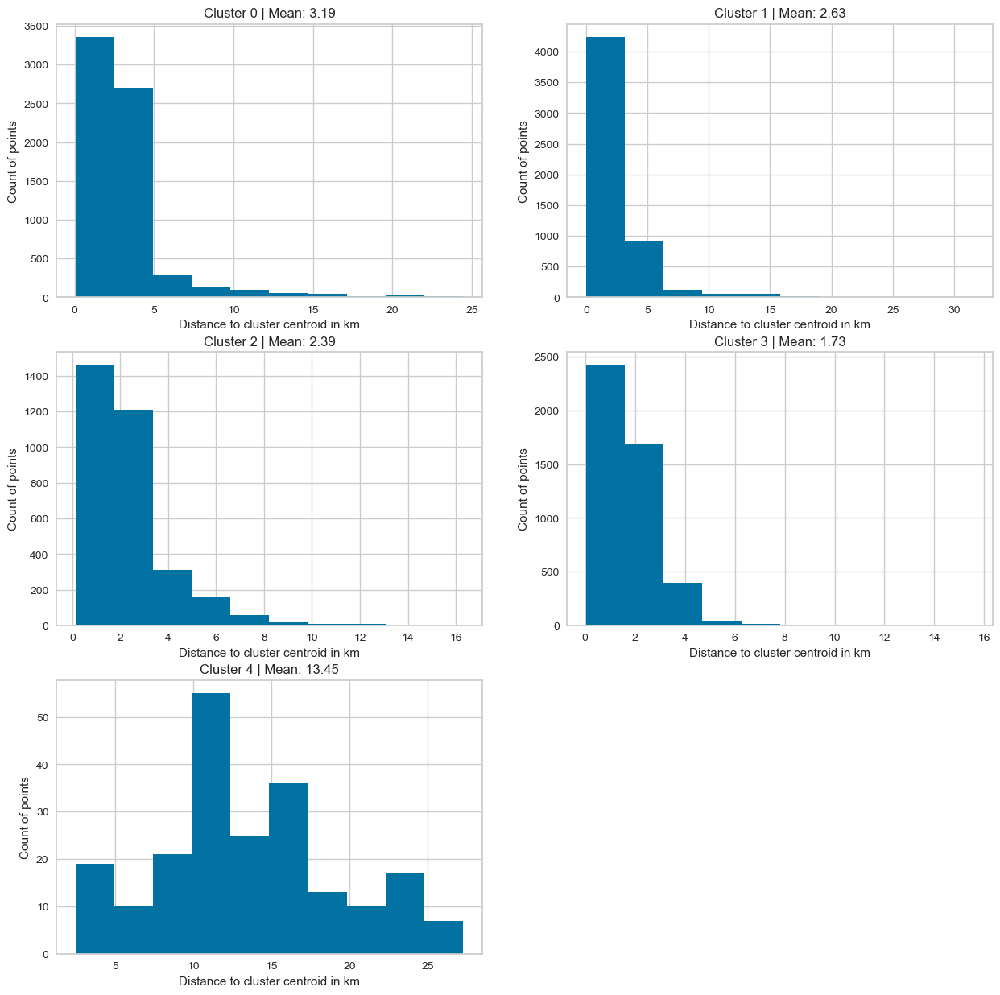

In [16]:
def arrange_subplots(distances, n_plots):

  # Calcula o número de linhas e colunas
  n_cols = int(np.sqrt(n_plots))
  n_rows = int(np.ceil(n_plots / n_cols))

  # Configura o gráfico
  gs = gridspec.GridSpec(n_rows, n_cols)
  scale = max(n_cols, n_rows)
  fig = plt.figure(figsize=(5 * scale, 5 * scale))

  # Carrega dos dados de cada subgráfico
  for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    ax.hist(distances[i])
    ax.set_title('Cluster {} | Mean: {}'.format(i, round(np.mean(distances[i]), 2)))
    ax.set_xlabel('Distance to cluster centroid in km')
    ax.set_ylabel('Count of points')

arrange_subplots(distances = distances, n_plots = len(distances))

Vamos salvar algumas estatísticas do nosso modelo e definir nossa regra para retreinar o modelo ao processar novos dados de treino no futuro.

In [17]:
drift_params = dict()
for k, v in distances.items():

    # Percorre cada ponto de treino para calcular outliers and inner_radius
    outliers = []
    inner_radius = []
    for x in v:
        z_score = (x - np.mean(v)) / np.std(v)
        outliers += [z_score >= 2]
        inner_radius += [x <= 5]
        

    # Cataloga as informações de drift para o cluster
    drift_params[k] = {
        'mean': round(np.mean(v), 2),
        'stdev': round(np.std(v), 2),
        'perc_outliers': round(sum(outliers) / len(outliers), 4),
        'perc_inner_radius': round(sum(inner_radius) / len(inner_radius), 4)
    }
    
drift_params

{np.int32(3): {'mean': np.float64(1.73),
  'stdev': np.float64(1.21),
  'perc_outliers': np.float64(0.0295),
  'perc_inner_radius': 0.9849},
 np.int32(2): {'mean': np.float64(2.39),
  'stdev': np.float64(1.86),
  'perc_outliers': np.float64(0.0507),
  'perc_inner_radius': 0.9167},
 np.int32(4): {'mean': np.float64(13.45),
  'stdev': np.float64(5.73),
  'perc_outliers': np.float64(0.0282),
  'perc_inner_radius': 0.0892},
 np.int32(1): {'mean': np.float64(2.63),
  'stdev': np.float64(2.68),
  'perc_outliers': np.float64(0.0322),
  'perc_inner_radius': 0.8909},
 np.int32(0): {'mean': np.float64(3.19),
  'stdev': np.float64(2.73),
  'perc_outliers': np.float64(0.0451),
  'perc_inner_radius': 0.9014}}

In [18]:
# Salva o arquivo em disco
dump(drift_params, '../temp/drift_params.joblib') 

# Lê o arquivo do disco
drift_params_new = load('../temp/drift_params.joblib') 
drift_params_new

{np.int32(3): {'mean': np.float64(1.73),
  'stdev': np.float64(1.21),
  'perc_outliers': np.float64(0.0295),
  'perc_inner_radius': 0.9849},
 np.int32(2): {'mean': np.float64(2.39),
  'stdev': np.float64(1.86),
  'perc_outliers': np.float64(0.0507),
  'perc_inner_radius': 0.9167},
 np.int32(4): {'mean': np.float64(13.45),
  'stdev': np.float64(5.73),
  'perc_outliers': np.float64(0.0282),
  'perc_inner_radius': 0.0892},
 np.int32(1): {'mean': np.float64(2.63),
  'stdev': np.float64(2.68),
  'perc_outliers': np.float64(0.0322),
  'perc_inner_radius': 0.8909},
 np.int32(0): {'mean': np.float64(3.19),
  'stdev': np.float64(2.73),
  'perc_outliers': np.float64(0.0451),
  'perc_inner_radius': 0.9014}}

In [19]:
# Calcula a média de perc_inner_radius
model_metric = [] 
for k, v in drift_params.items():
    model_metric += [v['perc_inner_radius']] 
model_metric = np.mean(model_metric)

model_metric

np.float64(0.7566200000000001)

<div class="custom-slide">
    <h1>Model Drift</h1>
    <p>
       O termo "drift" é usado para fazer referência à mudança na distribuição dos dados do modelo. Essa análise de mudança na distribuição dos dados pode ser analisada sob duas perspectivas:
    </p>
    <ul>
        <li>
            Data drift: é analisada a mudança na distribuição dos dados de entrada do modelo (os dados que são utilizados para treiná-lo). 
            Isso pode acontecer por vários fatores, como: 
            <p>- Mudanças no ambiente operacional: Por exemplo, mudanças no comportamento do usuário, novos padrões de uso, ou alterações sazonais.<br>
            - Mudanças no processo de coleta de dados: Alterações na maneira como os dados são coletados, processados ou armazenados.<br>
            - Introdução de novos tipos de dados: Novas variáveis ou fontes de dados podem ser incorporadas.</p>
        </li>
        <li>
            Concept drift: refere-se à mudanças na relação subjacente entre as entradas (features) e as saídas (target). Esta mudança pode ser súbita, gradual ou recorrente.
        </li>
    </ul>  
    <table>
        <tr>
            <th>Aspecto</th>
            <th>Data Drift</th>
            <th>Concept Drift</th>
        </tr>
        <tr>
            <td>O que muda</td>
            <td>Distribuição dos dados de entrada</td>
            <td>Relação entre entradas e saídas (conceito)</td>
        </tr>
        <tr>
            <td>Causa</td>
            <td>Mudanças no ambiente, coleta de dados, etc.</td>
            <td>Mudanças no sistema subjacente ou no comportamento</td>
        </tr>
        <tr>
            <td>Impacto</td>
            <td>Pode levar a previsões menos precisas</td>
            <td>Pode tornar o modelo obsoleto</td>
        </tr>
        <tr>
            <td>Detecção</td>
            <td>Monitoramento da distribuição das features</td>
            <td>Análise de performance e detecção de mudanças</td>
        </tr>
        <tr>
            <td>Solução</td>
            <td>Atualização do modelo com novos dados</td>
            <td>Re-treino do modelo com novos dados</td>
        </tr>
    </table>
</div>